In [1]:
import math 
import os
from pathlib import Path
import heapq
from collections import *
import time

import cv2
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid

In [2]:
BASE_PATH = Path('/Users/vinay/ub/spring-22/CSE573-CVIP/BackgroundStitching/images/pano')

In [227]:
def gray(img):
    img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    return img

def otsu(img, bt=5, t=127):
    # g = gray(img)
    # b = cv2.medianBlur(g, bt)
    res = cv2.adaptiveThreshold(img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 21, 4)
    return res

# def count_black(img, span=20):
#     h, w, _ = shape(img)
#     counts = []
    
#     for i in range(0, w, span):
#         region = img[:, i:i+span]
#         b_count = len(np.where(region == 0.0)[0])
#         counts.append(b_count)
        
#     return counts

# def estimate_overlap(img1, img2, span=20):
#     img1 = otsu(img1, bt=1, t=127)
#     img2 = otsu(img2, bt=1, t=127)
    
#     bc1 = count_black(img1, span)
#     bc2 = count_black(img2, span)
#     min_val = float('inf')
#     jmin = None
    
#     for i in range(10):
#         a = np.array(bc1[i:i+10])
#         b = np.array(bc2[i:i+10])
#         a_minus_b = np.abs(a-b)
#         ab_mean = a_minus_b.mean()
#         if ab_mean < min_val:
#             min_val = ab_mean
#             jmin = i
            
#     print(jmin)
#     o1 = (0, 0, (img1.shape[1] - jmin * span), img1.shape[0])
#     o2 = (span*jmin, 0, (img2.shape[1] - jmin * span), img2.shape[0])
            
#     return o1, o2

# o1, o2 = estimate_overlap(imgs1[2], imgs1[3])
# show(imgs1[2][o1[1]:o1[3], o1[0]:o1[2]])
# show(imgs1[3][o2[1]:o2[3], o2[0]:o2[2]])

In [307]:
def resize(img, factor):
    h, w, a = shape(img)
    op = cv2.resize(img, (int(w*factor), int(h*factor)))
    return op

def show_batch(imgs, size=20, dpi=100):
    n = len(imgs)
    col = 4
    row = (n // col) + 1 
    fig = plt.figure(figsize=(size, size), dpi=dpi)
    grid = ImageGrid(
        fig, 111,
        nrows_ncols=(row, col), 
        axes_pad=0.4, 
     )
    
    for idx, (ax, im) in enumerate(zip(grid, imgs)):
        # Iterating over the grid returns the Axes.
        im= cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
        ax.imshow(im, cmap='gray')
        ax.set_title(f'Image {idx}')
        
    plt.show()

def read_batch(path, scale_factor = 1.0):
    imgs = {}
    lis = list(os.walk(path))
    
    if lis:
        p, _, files = lis[0]
        idx = 0
        for file in files:
            if '.DS_Store' not in file:
                imgs[idx] = cv2.imread(f'{p}/{file}')
                if scale_factor != 1.0:
                    imgs[idx] = resize(imgs[idx], scale_factor)
                idx += 1

    return imgs

def show(img, dpi=100, disable_axis=True, color=True):
    if color:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        
    plt.figure(dpi=dpi)
    plt.imshow(img, cmap='gray')
    
    if disable_axis:
        ax = plt.gca()
        ax.axes.xaxis.set_visible(False)
        ax.axes.yaxis.set_visible(False)
        
def shape(img):
    s = img.shape
    a = 0
    if len(s) == 3:
        h, w, a = img.shape
    else:
        h, w = img.shape
        
    return h, w, a

def img2c(img):
    size = img.shape
    return (0, 0, size[1], size[0])

def extract_features(image, extractor):
    keypoints, desc = extractor.detectAndCompute(image, None)
    return keypoints, desc

def extract_all_features(imgs):
    sift = cv2.SIFT_create()
    feature_desc = np.array(
        list(map(lambda x: extract_features(x, sift), imgs)),
        dtype=object,
    )[:, 1]
    
    return feature_desc

def pairwise(X, Y):
    dists = -2 * np.dot(X, Y.T) + np.sum(np.square(Y), axis=1, keepdims=True).T + np.sum(np.square(X), axis=1, keepdims=True)
    return np.sqrt(dists)

def get_matching_points(matches, kp1, kp2):
    src_pts = np.float32([ kp1[m.queryIdx].pt for m in matches ])
    dst_pts = np.float32([ kp2[m.trainIdx].pt for m in matches ])
    return src_pts, dst_pts

def match_desc(desc1, desc2, lowes_ratio):
    pair_dist = pairwise(desc1, desc2)
    min_pairs = np.partition(pair_dist, 1)[:, :2]
    idx = (min_pairs[:, 0] / min_pairs[:, 1]) < lowes_ratio
    n_matches = len(min_pairs[idx])
    matches = []

    for q_idx, t_idx in zip(np.nonzero(idx)[0], np.argmin(pair_dist[idx], 1)):
        matches.append(
            cv2.DMatch(
                _queryIdx=q_idx,
                _trainIdx=t_idx,
                _distance=pair_dist[q_idx, t_idx],
            )
        )
        
    return matches, n_matches

def homography(match_pts, typ=cv2.RANSAC):
    src_pts, dst_pts = match_pts
    
    if len(src_pts) > 4:
        h, mask = cv2.findHomography(src_pts, dst_pts, typ, 5.0)
    else:
        h, mask = np.array([[0, 0, 0], [0, 0, 0], [0, 0, 0]]), None
    
    if mask is not None:
        print(f'after h: inliers: {mask.sum()}')
    
    return h, mask

def translate(dx, dy):
    t = np.float32(
        [
            [1, 0, dx],
            [0, 1, dy],
            [0, 0,  1],
        ]
    )
    return t

def translate_homography(dx, dy, H):
    dx, dy = abs(dx) if dx < 0 else 0, abs(dy) if dy < 0 else 0
    transform = np.float32(
        [
            [1, 0, dx],
            [0, 1, dy],
            [0, 0,  1],
        ]
    )
    new_h = transform.dot(H)
    return new_h, (dx, dy)

def apply_homography(args, img1, img2, H, mask):
    img1 = img1.copy()
    img2 = img2.copy()
    
    h, w, _ = shape(img1)
    (matches, (kp1, kp2)) = args
    
    pts = np.float32([ [0, 0],[0, h-1],[w-1, h-1],[w-1, 0] ]).reshape(-1, 1, 2)
    dst = cv2.perspectiveTransform(pts, H)
    img2 = cv2.polylines(img2, [np.int32(dst)], True, 255, 3, cv2.LINE_AA)
    
    draw_params = dict(
        matchColor = (0, 255, 0), 
        singlePointColor = None,
        matchesMask = mask,
        flags = 2,
    )
    img = cv2.drawMatches(img1, kp1, img2, kp2, matches, None, **draw_params)
    
    return img

def transform(coordinates, homography):
    x, y, w, h = coordinates
    src = np.float32([[x, y], [x, y + h - 1], [x + w - 1, y], [x + w - 1, y + h - 1]]).reshape(-1, 1, 2)
    
    dst = cv2.perspectiveTransform(src, homography)
    l, _, _ = dst.shape
    dst = dst.reshape((l, 2))
    
    min_x, max_x = np.min(dst[:, 0]), np.max(dst[:, 0])
    min_y, max_y = np.min(dst[:, 1]), np.max(dst[:, 1])
    
    new_x = int(np.floor(min_x))
    new_y = int(np.floor(min_y))
    new_w = int(np.ceil(max_x - min_x))
    new_h = int(np.ceil(max_y - min_y))
    
    return new_x, new_y, new_w, new_h

def addBorder(img, rect):
    top, bottom, left, right = int(0), int(0), int(0), int(0)
    x, y, w, h = rect
    tl = (x, y)    
    br = (x + w, y + h)
    if tl[1] < 0:
        top = -tl[1]
    if br[1] > img.shape[0]:
        bottom = br[1] - img.shape[0]
    if tl[0] < 0:
        left = -tl[0]
    if br[0] > img.shape[1]:
        right = br[0] - img.shape[1]
        
    img = cv2.copyMakeBorder(img, top, bottom, left, right,
                            cv2.BORDER_CONSTANT, value=[0, 0, 0])
    orig = (left, top)
    return img, orig

def mean_blend(img1, img2):
    assert(img1.shape == img2.shape)
    locs1 = np.where(cv2.cvtColor(img1, cv2.COLOR_RGB2GRAY) != 0)
    blended1 = np.copy(img2)
    blended1[locs1[0], locs1[1]] = img1[locs1[0], locs1[1]]
    locs2 = np.where(cv2.cvtColor(img2, cv2.COLOR_RGB2GRAY) != 0)
    blended2 = np.copy(img1)
    blended2[locs2[0], locs2[1]] = img2[locs2[0], locs2[1]]
    blended = cv2.addWeighted(blended1, 0.5, blended2, 0.5, 0)
    return blended

def warp(img_c, H):
    _, _, a = shape(img_c)
    dx, dy, _, _ = transform(img2c(img_c), H)
    new_H, (tx, ty) = translate_homography(dx, dy, H)
    x, y, w, h = transform(img2c(img_c), new_H)
    warped = cv2.warpPerspective(img_c, new_H, (x+w, y+h))
    # print(f'xpos:{dx}, ypos:{dy}')
    return warped, (tx, ty)

def merge(img1_c, img2_c, H):
    result, pos = warp(img1_c, H)
    xpos, ypos = pos
    # print(f'xpos:{xpos}, ypos:{ypos}')
    rect = (xpos, ypos, img2_c.shape[1], img2_c.shape[0])
    result, _ = addBorder(result, rect)
    idx = np.s_[ypos : ypos + img2_c.shape[0], xpos : xpos + img2_c.shape[1]]
    result[idx] = mean_blend(result[idx], img2_c)
    x, y, w, h = cv2.boundingRect(cv2.cvtColor(result, cv2.COLOR_RGB2GRAY))
    result = result[y : y + h, x : x + w]
    
    return result, (xpos-x, ypos-y)

def ransac(match_pts, thresh, factor, p=10, n=10000, prob=0.99):
    src_pts, dst_pts = match_pts
    k = len(src_pts)
    
    min_error = float('inf')
    best_inliers = float('-inf')
    mask = []
    src_pts_f = []
    dest_pts_f = []
    print('\n')
    for i in range(n):
        rand_idx = np.random.choice(k, p)
        src_pts_s = src_pts[rand_idx]
        dst_pts_s = dst_pts[rand_idx]

        H, _ = cv2.findHomography(src_pts_s.reshape(-1, 1, 2), dst_pts_s.reshape(-1, 1, 2))
        dst_pts_p = cv2.perspectiveTransform(src_pts.reshape(-1, 1, 2), H).reshape(-1, 2)

        errors = np.linalg.norm(dst_pts_p - dst_pts, axis=1)
        errors = errors / factor
        inliers = errors < thresh
        n_inliers = inliers.sum()
        
        if n_inliers > best_inliers:
            mean_error = round(errors.mean(), 2)
            print(f'idx:{i}, mean_error:{mean_error}, n_inliers:{n_inliers}, prob:{round(n_inliers/k, 2)}')
            best_inliers = n_inliers
            src_pts_f = src_pts[inliers]
            dest_pts_f = dst_pts[inliers]
            mask = inliers
            
        if n_inliers/k > prob:
            # print('break')
            break

    return src_pts_f, dest_pts_f, mask.astype(np.uint8)

def remove_border(img):
    x, y, w, h = cv2.boundingRect(cv2.cvtColor(img, cv2.COLOR_RGB2GRAY))
    img = img[y : y + h, x : x + w]
    return img

def get_H(
    img1_c, img2_c, ransac_thresh,
    matches, kp1, kp2, cv, typ=cv2.RANSAC,
):
    sift = cv2.SIFT_create()
    img1 = cv2.cvtColor(img1_c, cv2.COLOR_BGR2GRAY)
    img2 = cv2.cvtColor(img2_c, cv2.COLOR_BGR2GRAY)
    
    h1, w1 = img1.shape
    h2, w2 = img2.shape
    
    src_pts, dst_pts = get_matching_points(matches, kp1, kp2)
    
    if cv is False:
        K = math.sqrt((h1 + h2)**2 + (w1 + w2)**2)
        src_pts, dst_pts, mask = ransac(
            (src_pts, dst_pts), thresh=ransac_thresh, factor=1,
        )
        print(f'after ransac n_matches: {len(src_pts)}')
        
    H, mask = homography((src_pts, dst_pts), typ=typ)
    
    return H, mask

def stitch(img1, img2, ransac_thresh, matches, kp1, kp2, cv):
    H, _ = get_H(
        img1, img2, ransac_thresh=ransac_thresh,
        matches=matches, kp1=kp1, kp2=kp2, cv=cv,
    )
    img, _ = merge(img1, img2, H)
    return img

def pano(
    imgs, descriptors, keypoints, 
    extractor, match_thresh, ransac_thresh, 
    lowes_ratio, show_inter, cv,
):
    nxt_imgs = []
    nxt_desc = []
    nxt_kp = []
    n = len(imgs)
    helper = np.ones(n)
    curr = 0
    flag = True
    stitched_img = None
    
    while True:
        curr = np.where(helper == 1)[0][0]
        helper[curr] = 0
        
        best_n = float('-inf')
        best_nxt = None
        best_matches = []
        temp = None
        
        for nxt in np.where(helper == 1)[0]:
            # matches, n_matches = match_desc(
            #     descriptors[curr],
            #     descriptors[nxt],
            #     lowes_ratio=lowes_ratio,
            # )
            
            matches, n_matches = match_desc(
                descriptors[nxt],
                descriptors[curr],
                lowes_ratio=lowes_ratio,
            )
            
            try:
                temp = n_matches
                # _, mask = get_H(
                #     imgs[curr], imgs[nxt], ransac_thresh=ransac_thresh,
                #     matches=matches, kp1=keypoints[curr], kp2=keypoints[nxt],
                #     cv=cv, typ=cv2.USAC_MAGSAC,
                # )
                _, mask = get_H(
                    imgs[nxt], imgs[curr], ransac_thresh=ransac_thresh,
                    matches=matches, kp1=keypoints[nxt], kp2=keypoints[curr],
                    cv=cv, typ=cv2.USAC_MAGSAC,
                )
                n_matches = mask.sum()
            except Exception as e:
                print('No.of Inlier less than required')
                
            print(f'curr:{curr}, nxt:{nxt}, n_matches_b:{temp}, n_matches_a:{n_matches}')
            
            if n_matches > best_n and n_matches > match_thresh:
                best_n = n_matches
                best_nxt = nxt
                best_matches = matches
        
        if best_nxt is not None:
            print(f'curr:{curr}, best_nxt:{best_nxt}, n_matches:{best_n}')
            helper[best_nxt] = 0
            # stitched_img = stitch(
            #     img1=imgs[curr], img2=imgs[best_nxt], cv=cv, 
            #     kp1=keypoints[curr], kp2=keypoints[best_nxt],
            #     ransac_thresh=ransac_thresh, matches=best_matches,
            # )
            stitched_img = stitch(
                img1=imgs[best_nxt], img2=imgs[curr], cv=cv, 
                kp1=keypoints[best_nxt], kp2=keypoints[curr],
                ransac_thresh=ransac_thresh, matches=best_matches,
            )

            nxt_imgs.append(stitched_img)
            kps, fds = extract_features(stitched_img, extractor)
            nxt_desc.append(fds)
            nxt_kp.append(kps)
            
            print(f'\nStitched {curr}, {best_nxt} | shape: {nxt_imgs[-1].shape}\n')
            
            if show_inter:
                show(nxt_imgs[-1])
        elif flag is False:
            nxt_imgs.append(imgs[curr])
            nxt_desc.append(descriptors[curr])
            nxt_kp.append(keypoints[curr])
            
        flag = False
        if np.where(helper == 1)[0].shape[0] == 0:
            break
            
    return nxt_imgs, nxt_desc, nxt_kp, stitched_img

def stitch_pano(
    imgs, ransac_thresh=10, match_thresh=100,
    lowes_ratio=0.7, show_inter=False, cv=True,
):
    sift = cv2.SIFT_create()
    descriptors = []
    keypoints = []
    
    for idx, img in enumerate(imgs):
        kp, desc = extract_features(img, sift)
        keypoints.append(kp)
        descriptors.append(desc)
        
    count = 0
    res = None
    while imgs:
        print('------------------------------')
        print(f'iter: {count}, imgs: {len(imgs)}\n')
        imgs, descriptors, keypoints, stitched_img = pano(
            imgs=imgs, descriptors=descriptors, keypoints=keypoints, 
            extractor=sift, match_thresh=match_thresh, 
            ransac_thresh=ransac_thresh, lowes_ratio=lowes_ratio,
            show_inter=show_inter, cv=cv,
        ) 
        if stitched_img is not None:
            res = stitched_img
        
    return res

def get_overlap(imgs, fd, thresh, lowes_ratio=0.7):
    match_score = get_all_matches(imgs, fd, lowes_ratio)
    x = np.array(list(match_score.values()))
    temp = x.copy()
    h, w = x.shape
    for i in range(h):
        for j in range(w):
            if i == j:
                x[i][j] = 1
                continue
            if x[i][j] > thresh:
                x[i][j] = 1
            else:
                x[i][j] = 0

    return temp, x

def get_all_matches(imgs, feature_desc, lowes_ratio):
    n = len(imgs)
    all_matches = defaultdict(lambda: np.zeros(n))

    for idx, img1 in enumerate(imgs):
        desc1 = feature_desc[idx]

        for jdx, img2 in enumerate(imgs):
            if idx == jdx:
                continue

            desc2 = feature_desc[jdx]
            _, n_matches = match_desc(desc1, desc2, lowes_ratio=lowes_ratio)
            all_matches[idx][jdx] = n_matches

    return dict(all_matches)

In [267]:
def hist(image):
    m = int(np.max(image)) + 1
    res = {i: 0 for i in range(m)}
    h, w = image.shape
    for i in range(h):
        for j in range(w):
            res[image[i][j]] += 1

    return list(res.values()), list(res.keys())


def otsu(image, *args, **kwargs):
    m = int(np.max(image)) + 1
    total_pixels = image.shape[0] * image.shape[1]
    mean_weight = 1.0 / total_pixels
    his, bins = hist(image)
    # his, bins = np.histogram(image, np.arange(0, 257))
    final_thresh = -1
    final_value = -1
    intensity_arr = np.arange(m)

    for thresh in bins[1:-1]:
        left = np.sum(his[:thresh])
        right = np.sum(his[thresh:])
        w_left = left * mean_weight
        w_right = right * mean_weight

        mub = np.sum(intensity_arr[:thresh] * his[:thresh]) / float(left)
        muf = np.sum(intensity_arr[thresh:] * his[thresh:]) / float(right)

        value = w_left * w_right * (mub - muf) ** 2

        if value > final_value:
            final_thresh = thresh
            final_value = value

    output = image.copy()
    output[image > final_thresh] = 1
    output[image < final_thresh] = 0

    return output

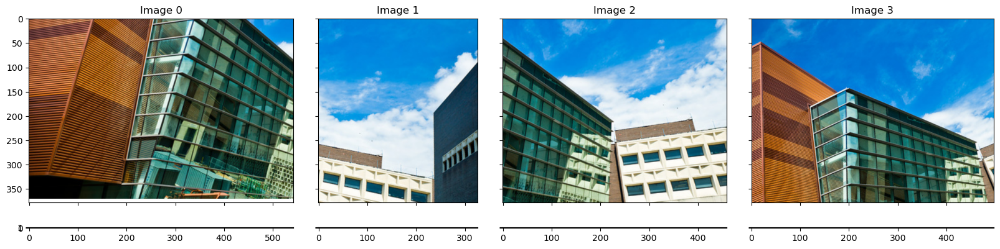

In [322]:
imgs1 = read_batch(BASE_PATH/'1', 1)
fd1 = extract_all_features(imgs1.values())
show_batch(imgs1.values())

------------------------------
iter: 0, imgs: 4



idx:0, mean_error:0.0, n_inliers:2, prob:1.0
after ransac n_matches: 2
'NoneType' object has no attribute 'sum'
curr:0, nxt:1, n_matches_b:2, n_matches_a:2


idx:0, mean_error:3.569999933242798, n_inliers:435, prob:1.0
after ransac n_matches: 435
after h: inliers: 415
curr:0, nxt:2, n_matches_b:435, n_matches_a:415


idx:0, mean_error:6.150000095367432, n_inliers:317, prob:1.0
after ransac n_matches: 317
after h: inliers: 298
curr:0, nxt:3, n_matches_b:317, n_matches_a:298
curr:0, best_nxt:2, n_matches:415


idx:0, mean_error:371.7699890136719, n_inliers:431, prob:0.99
after ransac n_matches: 431
after h: inliers: 411

Stitched 0, 2 | shape: (449, 859, 3)



idx:0, mean_error:5401.8701171875, n_inliers:16, prob:0.94
idx:1, mean_error:147.08999633789062, n_inliers:17, prob:1.0
after ransac n_matches: 17
after h: inliers: 10
curr:1, nxt:3, n_matches_b:17, n_matches_a:10
------------------------------
iter: 0, imgs: 3



idx:0, mean_error

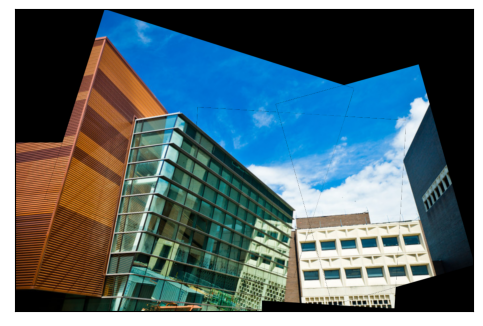

In [81]:
# %%timeit
res = stitch_pano(
    list(imgs1.values()), ransac_thresh=5000, match_thresh=50, lowes_ratio=0.7, cv=False, show_inter=False,
)
show(res)

In [327]:
overlap

array([[1., 0., 1., 1.],
       [0., 1., 1., 0.],
       [1., 1., 1., 1.],
       [1., 0., 1., 1.]])

In [326]:
x, overlap = get_overlap(imgs1, fd1, thresh=80, lowes_ratio=0.7)
x

array([[  0.,  17., 458., 337.],
       [  2.,   0., 177.,  21.],
       [435., 176.,   0., 301.],
       [317.,  17., 274.,   0.]])

In [226]:
x

array([[  0.,  17., 458., 337.],
       [  2.,   0., 177.,  21.],
       [435., 176.,   0., 301.],
       [317.,  17., 274.,   0.]])

In [205]:
x, overlap = get_overlap(imgs1, fd1, thresh=20, lowes_ratio=0.7)
overlap

array([[1., 0., 1., 1.],
       [0., 1., 1., 1.],
       [1., 1., 1., 1.],
       [1., 0., 1., 1.]])

In [260]:
np.max(x)

133.0

In [211]:
x, overlap = get_overlap(imgs1, fd1, thresh=20, lowes_ratio=0.7)
overlap

array([[1., 0., 1., 1.],
       [0., 1., 1., 0.],
       [1., 1., 1., 1.],
       [1., 1., 1., 1.]])

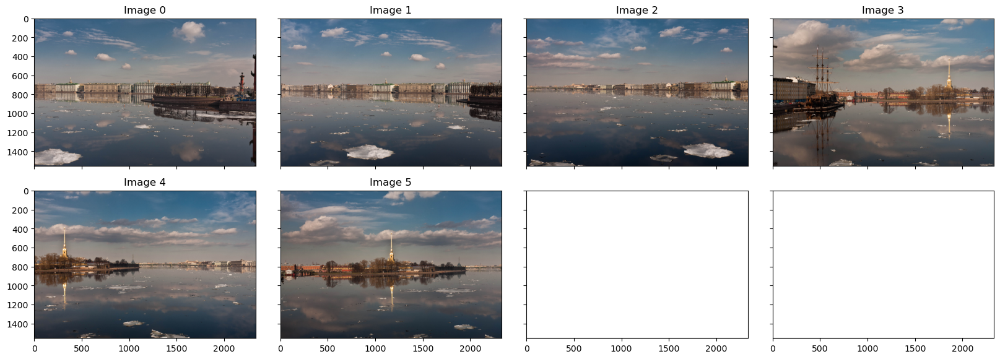

In [7]:
imgs2 = read_batch(BASE_PATH/'2', 0.6)
show_batch(imgs2.values())

------------------------------
iter: 0, imgs: 4

curr:0, nxt:1, n_matches:2508


idx:0, mean_error:11.229999542236328, n_inliers:2450, prob:0.98
idx:8, mean_error:11.880000114440918, n_inliers:2451, prob:0.98
idx:575, mean_error:14.550000190734863, n_inliers:2454, prob:0.98
after ransac n_matches: 2454
after h: inliers: 1806
curr:0, nxt:2, n_matches:920


idx:0, mean_error:38.650001525878906, n_inliers:790, prob:0.86
idx:1, mean_error:34.70000076293945, n_inliers:879, prob:0.96
idx:3, mean_error:31.09000015258789, n_inliers:892, prob:0.97
idx:13, mean_error:31.229999542236328, n_inliers:893, prob:0.97
idx:227, mean_error:30.889999389648438, n_inliers:894, prob:0.97
idx:315, mean_error:31.229999542236328, n_inliers:895, prob:0.97
idx:1556, mean_error:33.029998779296875, n_inliers:896, prob:0.97
after ransac n_matches: 896
after h: inliers: 635
curr:0, nxt:3, n_matches:35


idx:0, mean_error:2066.889892578125, n_inliers:0, prob:0.0
idx:6, mean_error:775.510009765625, n_inliers:1, prob:0.

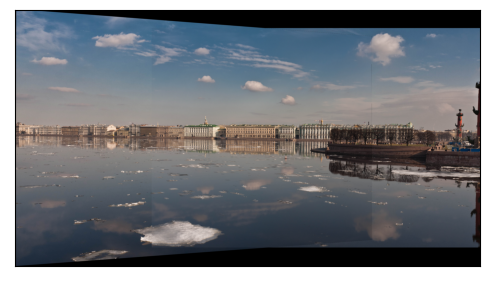

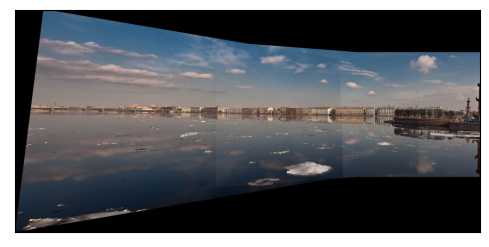

In [8]:
res = stitch_pano(
    list(imgs2.values())[:-2], ransac_thresh=50, match_thresh=50, lowes_ratio=0.7, cv=False, show_inter=True,
)

------------------------------
iter: 0, imgs: 4

after h: inliers: 2219
curr:0, nxt:1, n_matches_b:2508, n_matches_a:2219
after h: inliers: 748
curr:0, nxt:2, n_matches_b:920, n_matches_a:748
after h: inliers: 10
curr:0, nxt:3, n_matches_b:35, n_matches_a:10
curr:0, best_nxt:1, n_matches:2219
after h: inliers: 2098

Stitched 0, 1 | shape: (1824, 3307, 3)

after h: inliers: 5
curr:2, nxt:3, n_matches_b:22, n_matches_a:5
------------------------------
iter: 0, imgs: 3

after h: inliers: 1704
curr:0, nxt:1, n_matches_b:1805, n_matches_a:1704
after h: inliers: 5
curr:0, nxt:2, n_matches_b:18, n_matches_a:5
curr:0, best_nxt:1, n_matches:1704
after h: inliers: 1656

Stitched 0, 1 | shape: (2789, 5880, 3)

------------------------------
iter: 0, imgs: 2

after h: inliers: 4
curr:0, nxt:1, n_matches_b:18, n_matches_a:4
------------------------------
iter: 0, imgs: 1



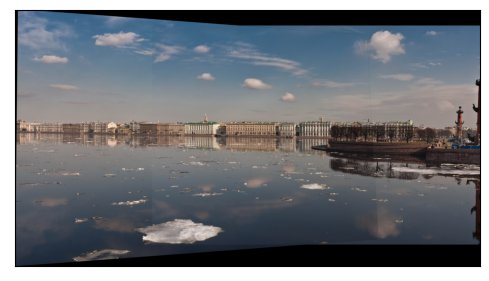

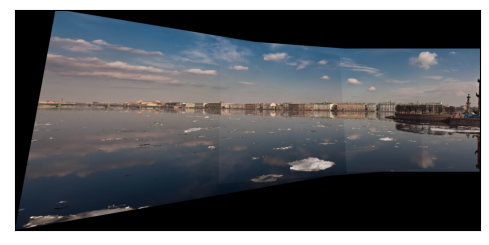

In [331]:
res = stitch_pano(
    list(imgs2.values())[:-2], ransac_thresh=10, match_thresh=50, lowes_ratio=0.7, show_inter=True, cv=True,
)

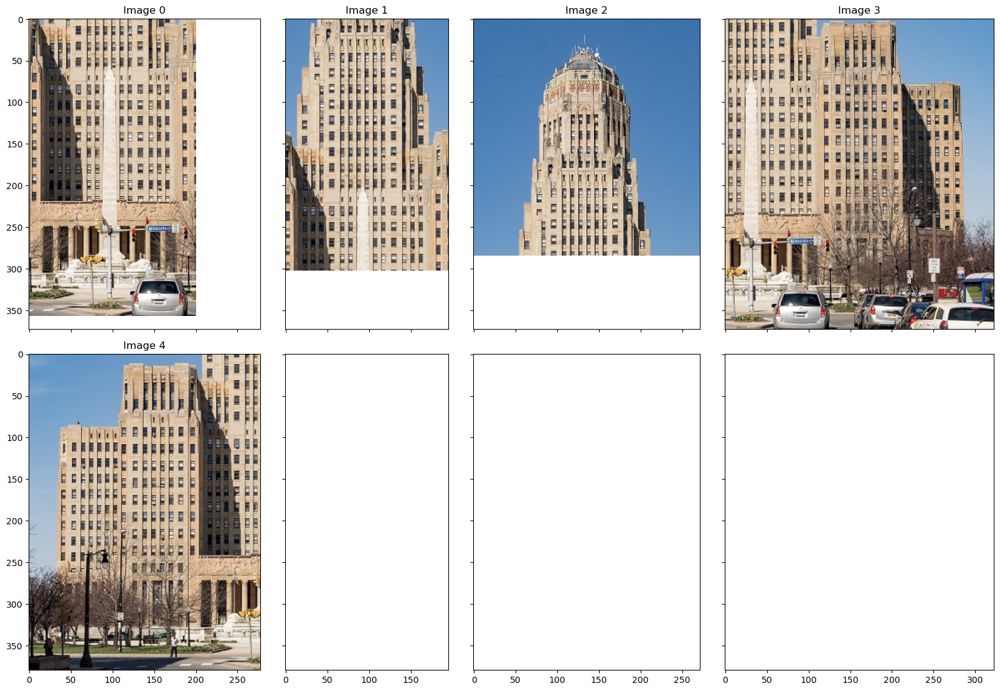

In [250]:
imgs3 = read_batch(BASE_PATH/'3', 0.5)
fd3 = extract_all_features(imgs3.values())
show_batch(imgs3.values())

In [243]:
res = stitch_pano(
    list(imgs3.values()), ransac_thresh=10, match_thresh=50, lowes_ratio=0.7, show_inter=False,
)

------------------------------
iter: 0, imgs: 5

after h: inliers: 1424
curr:0, nxt:1, n_matches_b:1506, n_matches_a:1424
after h: inliers: 11
curr:0, nxt:2, n_matches_b:49, n_matches_a:11
after h: inliers: 2156
curr:0, nxt:3, n_matches_b:2258, n_matches_a:2156
after h: inliers: 1520
curr:0, nxt:4, n_matches_b:1638, n_matches_a:1520
curr:0, best_nxt:3, n_matches:2156
after h: inliers: 2156

Stitched 0, 3 | shape: (745, 775, 3)

after h: inliers: 981
curr:1, nxt:2, n_matches_b:989, n_matches_a:981
after h: inliers: 752
curr:1, nxt:4, n_matches_b:873, n_matches_a:752
curr:1, best_nxt:2, n_matches:981
after h: inliers: 981

Stitched 1, 2 | shape: (931, 544, 3)

------------------------------
iter: 0, imgs: 3

after h: inliers: 1559
curr:0, nxt:1, n_matches_b:1619, n_matches_a:1559
after h: inliers: 1524
curr:0, nxt:2, n_matches_b:1621, n_matches_a:1524
curr:0, best_nxt:1, n_matches:1559
after h: inliers: 1559

Stitched 0, 1 | shape: (1333, 849, 3)

------------------------------
iter: 0, 

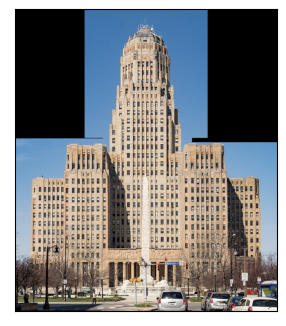

In [244]:
show(res)

In [252]:
x

array([[  0., 275.,  18., 314., 217.],
       [270.,   0., 153., 147., 130.],
       [ 13., 124.,   0.,   7.,   7.],
       [335., 159.,  15.,   0.,  40.],
       [239., 139.,  16.,  48.,   0.]])

In [251]:
x, overlap = get_overlap(imgs3, fd3, thresh=20, lowes_ratio=0.7)
overlap

array([[1., 1., 0., 1., 1.],
       [1., 1., 1., 1., 1.],
       [0., 1., 1., 0., 0.],
       [1., 1., 0., 1., 1.],
       [1., 1., 0., 1., 1.]])

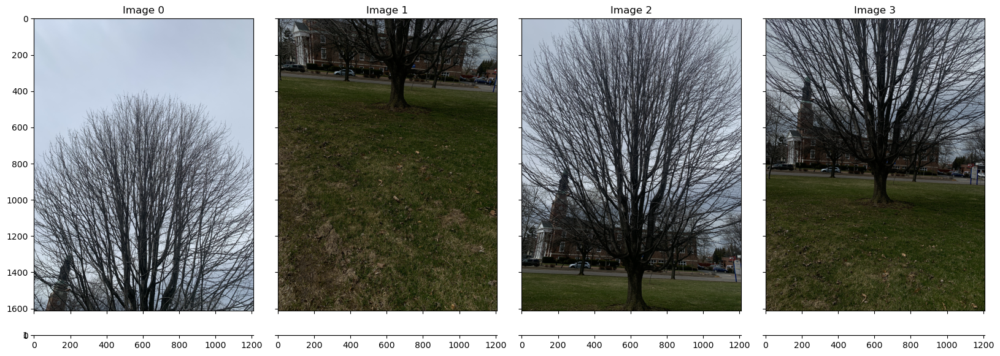

In [274]:
imgs4 = read_batch(BASE_PATH/'6', 0.4)
fd4 = extract_all_features(imgs4.values())
show_batch(imgs4.values())

------------------------------
iter: 0, imgs: 4

No.of Inlier less than required
curr:0, nxt:1, n_matches_b:1, n_matches_a:1
after h: inliers: 355
curr:0, nxt:2, n_matches_b:434, n_matches_a:355
after h: inliers: 30
curr:0, nxt:3, n_matches_b:60, n_matches_a:30
curr:0, best_nxt:2, n_matches:355
after h: inliers: 322

Stitched 0, 2 | shape: (2564, 1743, 3)

after h: inliers: 743
curr:1, nxt:3, n_matches_b:880, n_matches_a:743
curr:1, best_nxt:3, n_matches:743
after h: inliers: 624

Stitched 1, 3 | shape: (2513, 1787, 3)

------------------------------
iter: 0, imgs: 2

after h: inliers: 50
curr:0, nxt:1, n_matches_b:127, n_matches_a:50
------------------------------
iter: 0, imgs: 1



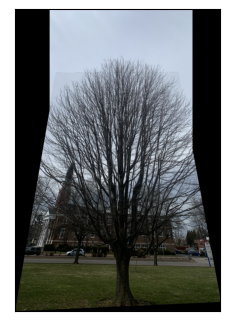

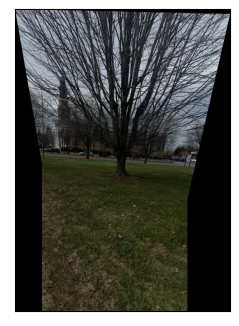

In [246]:
res = stitch_pano(
    list(imgs4.values()), ransac_thresh=10, match_thresh=50, lowes_ratio=0.7, show_inter=True,
)

In [275]:
x, overlap = get_overlap(imgs4, fd4, thresh=20, lowes_ratio=0.7)
x

array([[  0.,  18., 450.,  59.],
       [  1.,   0., 185., 899.],
       [434., 210.,   0., 472.],
       [ 60., 880., 449.,   0.]])

In [276]:
otsu(x)

array([[0., 0., 1., 0.],
       [0., 0., 0., 1.],
       [1., 0., 0., 1.],
       [0., 1., 1., 0.]])

In [269]:
x, overlap = get_overlap(imgs4, fd4, thresh=20, lowes_ratio=0.7)
x

array([[  0.,   3., 129.,  34.],
       [  1.,   0.,  54.,  66.],
       [133.,  73.,   0., 128.],
       [ 30.,  85., 121.,   0.]])

In [270]:
otsu(x)

array([[0., 0., 1., 0.],
       [0., 0., 0., 1.],
       [1., 1., 0., 1.],
       [0., 1., 1., 0.]])

In [254]:
x, overlap = get_overlap(imgs4, fd4, thresh=20, lowes_ratio=0.7)
x

array([[  0.,  18., 450.,  59.],
       [  1.,   0., 185., 899.],
       [434., 210.,   0., 472.],
       [ 60., 880., 449.,   0.]])

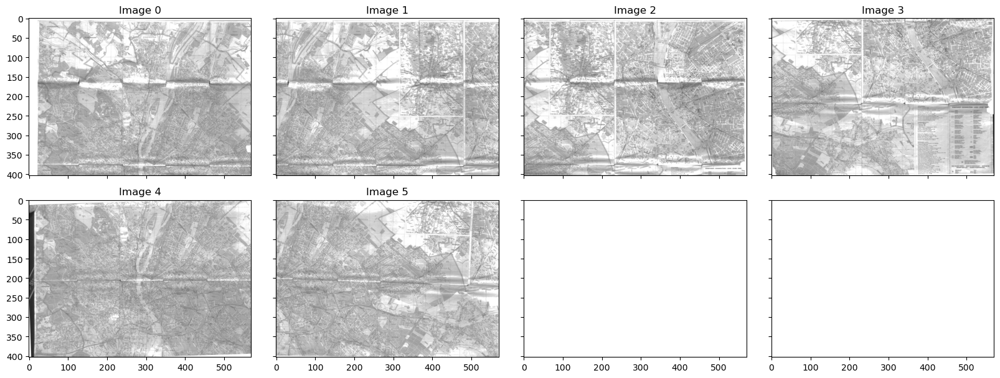

In [58]:
imgs7 = read_batch(BASE_PATH/'7', 0.5)
show_batch(imgs7.values())

------------------------------
iter: 0, imgs: 6

after h: inliers: 463
curr:0, nxt:1, n_matches_b:464, n_matches_a:463
'NoneType' object has no attribute 'sum'
curr:0, nxt:2, n_matches_b:3, n_matches_a:3
'NoneType' object has no attribute 'sum'
curr:0, nxt:3, n_matches_b:1, n_matches_a:1
after h: inliers: 505
curr:0, nxt:4, n_matches_b:506, n_matches_a:505
after h: inliers: 193
curr:0, nxt:5, n_matches_b:193, n_matches_a:193
curr:0, best_nxt:4, n_matches:505
after h: inliers: 505

Stitched 0, 4 | shape: (579, 577, 3)

after h: inliers: 852
curr:1, nxt:2, n_matches_b:857, n_matches_a:852
after h: inliers: 391
curr:1, nxt:3, n_matches_b:398, n_matches_a:391
after h: inliers: 617
curr:1, nxt:5, n_matches_b:618, n_matches_a:617
curr:1, best_nxt:2, n_matches:852
after h: inliers: 689

Stitched 1, 2 | shape: (413, 821, 3)

after h: inliers: 738
curr:3, nxt:5, n_matches_b:738, n_matches_a:738
curr:3, best_nxt:5, n_matches:738
after h: inliers: 673

Stitched 3, 5 | shape: (430, 865, 3)

------

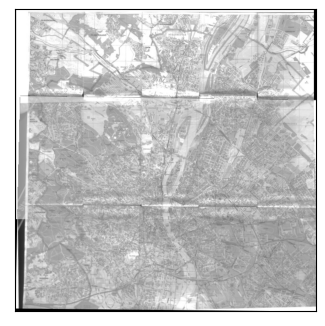

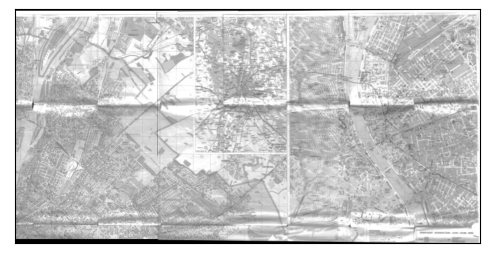

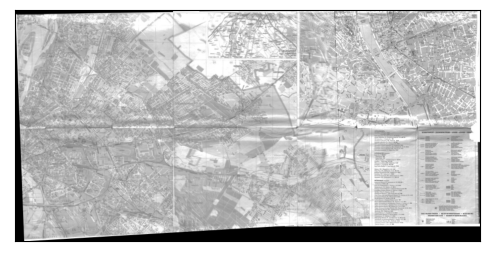

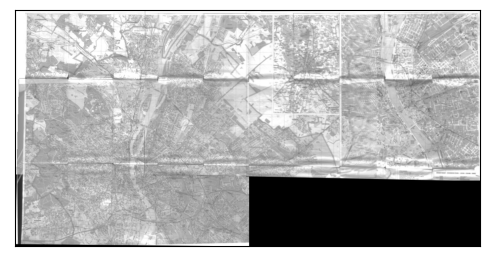

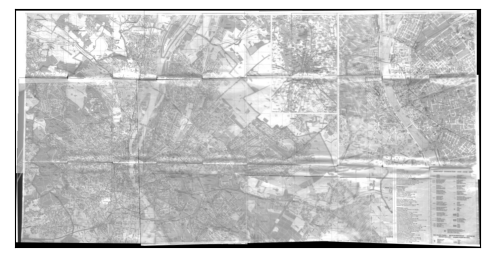

In [59]:
res = stitch_pano(
    list(imgs7.values()), ransac_thresh=10, match_thresh=50, lowes_ratio=0.7, show_inter=True,
)

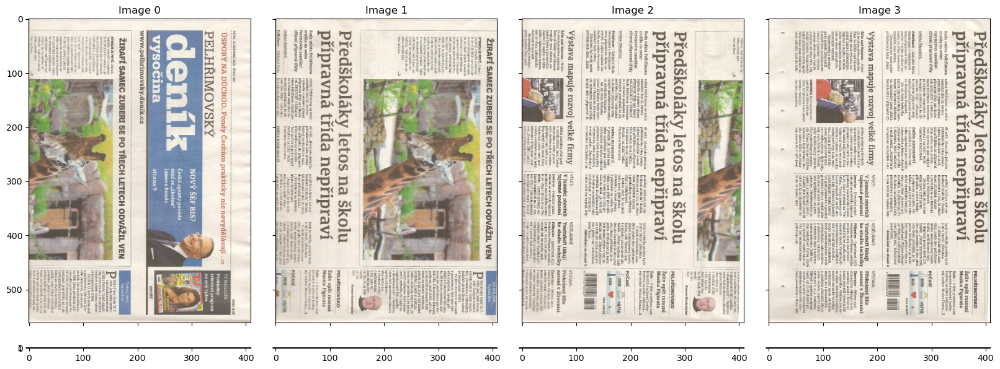

In [60]:
imgs8 = read_batch(BASE_PATH/'8', 0.5)
show_batch(imgs8.values())

------------------------------
iter: 0, imgs: 4

after h: inliers: 647
curr:0, nxt:1, n_matches_b:675, n_matches_a:647
after h: inliers: 6
curr:0, nxt:2, n_matches_b:33, n_matches_a:6
after h: inliers: 6
curr:0, nxt:3, n_matches_b:26, n_matches_a:6
curr:0, best_nxt:1, n_matches:647
after h: inliers: 647

Stitched 0, 1 | shape: (563, 631, 3)

after h: inliers: 1078
curr:2, nxt:3, n_matches_b:1154, n_matches_a:1078
curr:2, best_nxt:3, n_matches:1078
after h: inliers: 1078

Stitched 2, 3 | shape: (566, 513, 3)

------------------------------
iter: 1, imgs: 2

after h: inliers: 700
curr:0, nxt:1, n_matches_b:782, n_matches_a:700
curr:0, best_nxt:1, n_matches:700
after h: inliers: 700

Stitched 0, 1 | shape: (565, 894, 3)

------------------------------
iter: 2, imgs: 1



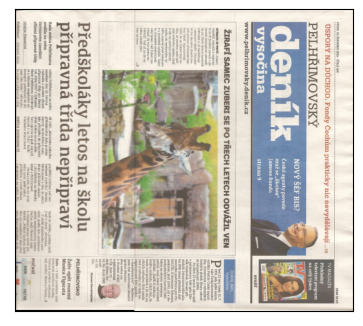

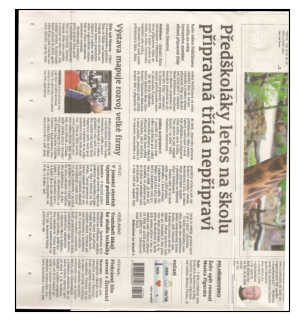

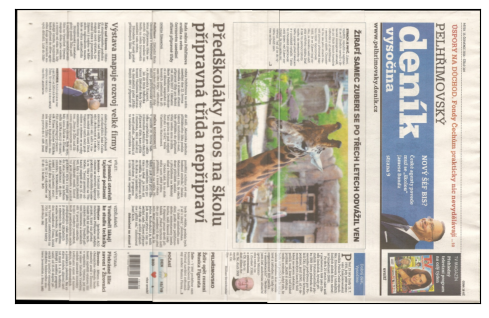

In [61]:
res = stitch_pano(
    list(imgs8.values()), ransac_thresh=10, match_thresh=50, lowes_ratio=0.7, show_inter=True,
)

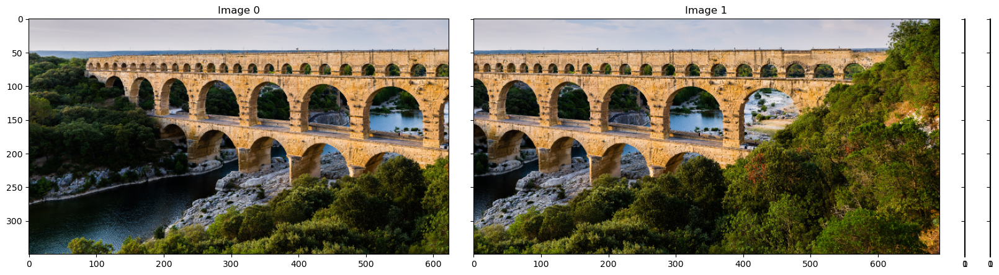

In [62]:
imgs9 = read_batch(BASE_PATH/'9', 0.5)
show_batch(imgs9.values())

------------------------------
iter: 0, imgs: 2

after h: inliers: 1030
curr:0, nxt:1, n_matches_b:1042, n_matches_a:1030
curr:0, best_nxt:1, n_matches:1030
after h: inliers: 1030

Stitched 0, 1 | shape: (351, 906, 3)

------------------------------
iter: 1, imgs: 1



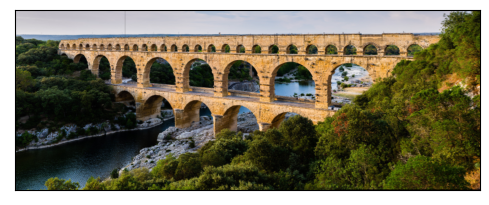

In [63]:
res = stitch_pano(
    list(imgs9.values()), ransac_thresh=10, match_thresh=50, lowes_ratio=0.7, show_inter=True,
)

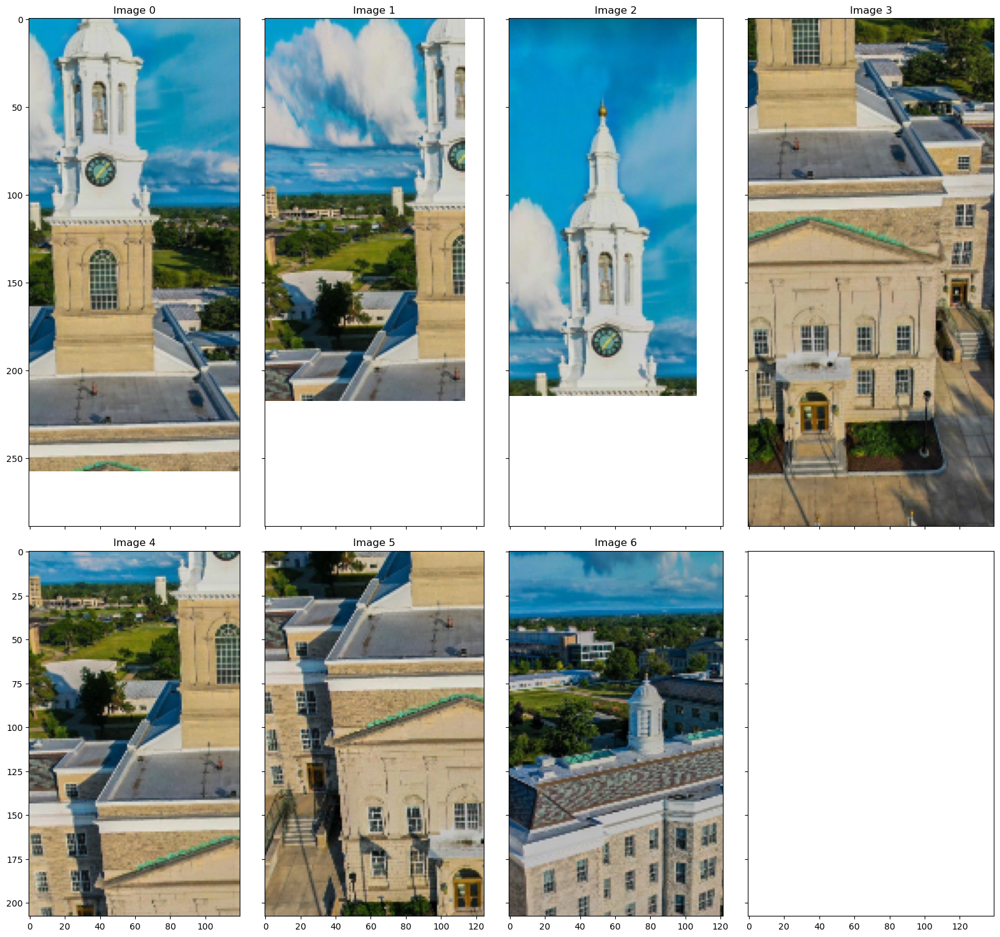

In [200]:
imgs10 = read_batch(BASE_PATH/'10', 0.5)
fd10 = extract_all_features(imgs10.values())
show_batch(imgs10.values())

In [155]:
res = stitch_pano(
    list(imgs10.values()), ransac_thresh=10, match_thresh=50, lowes_ratio=0.7, show_inter=False, cv=True,
)

------------------------------
iter: 0, imgs: 7

after h: inliers: 197
curr:0, nxt:1, n_matches_b:199, n_matches_a:197
after h: inliers: 280
curr:0, nxt:2, n_matches_b:280, n_matches_a:280
after h: inliers: 458
curr:0, nxt:3, n_matches_b:459, n_matches_a:458
after h: inliers: 186
curr:0, nxt:4, n_matches_b:190, n_matches_a:186
after h: inliers: 62
curr:0, nxt:5, n_matches_b:69, n_matches_a:62
No.of Inlier less than required
curr:0, nxt:6, n_matches_b:3, n_matches_a:3
curr:0, best_nxt:3, n_matches:458
after h: inliers: 458

Stitched 0, 3 | shape: (855, 298, 3)

after h: inliers: 134
curr:1, nxt:2, n_matches_b:138, n_matches_a:134
after h: inliers: 524
curr:1, nxt:4, n_matches_b:531, n_matches_a:524
after h: inliers: 150
curr:1, nxt:5, n_matches_b:165, n_matches_a:150
after h: inliers: 0
curr:1, nxt:6, n_matches_b:6, n_matches_a:0
curr:1, best_nxt:4, n_matches:524
after h: inliers: 524

Stitched 1, 4 | shape: (658, 240, 3)

after h: inliers: 0
curr:2, nxt:5, n_matches_b:12, n_matches_a:0

In [196]:
x.sum()

11826.0

In [195]:
x, overlap = get_overlap(imgs10, fd10, thresh=20, lowes_ratio=0.7)
overlap

array([[1., 1., 1., 1., 1., 1., 0.],
       [1., 1., 1., 1., 1., 1., 0.],
       [1., 1., 1., 0., 1., 0., 0.],
       [1., 1., 0., 1., 1., 1., 1.],
       [1., 1., 1., 1., 1., 1., 0.],
       [1., 1., 0., 1., 1., 1., 0.],
       [0., 0., 0., 0., 0., 0., 1.]])

In [199]:
y.sum()

6382.0

In [198]:
y, overlap = get_overlap(imgs10, fd10, thresh=20, lowes_ratio=0.7)
overlap

array([[1., 1., 1., 1., 1., 1., 0.],
       [1., 1., 1., 1., 1., 1., 0.],
       [1., 1., 1., 0., 1., 0., 0.],
       [1., 1., 0., 1., 1., 1., 0.],
       [1., 1., 1., 1., 1., 1., 0.],
       [1., 1., 0., 1., 1., 1., 0.],
       [0., 0., 0., 0., 0., 0., 1.]])

In [202]:
z.sum()

1246.0

In [201]:
z, overlap = get_overlap(imgs10, fd10, thresh=20, lowes_ratio=0.7)
overlap

array([[1., 1., 1., 1., 1., 0., 0.],
       [1., 1., 1., 0., 1., 1., 0.],
       [1., 1., 1., 0., 0., 0., 0.],
       [1., 0., 0., 1., 1., 1., 0.],
       [1., 1., 0., 0., 1., 1., 0.],
       [0., 1., 0., 1., 1., 1., 0.],
       [0., 0., 0., 0., 0., 0., 1.]])

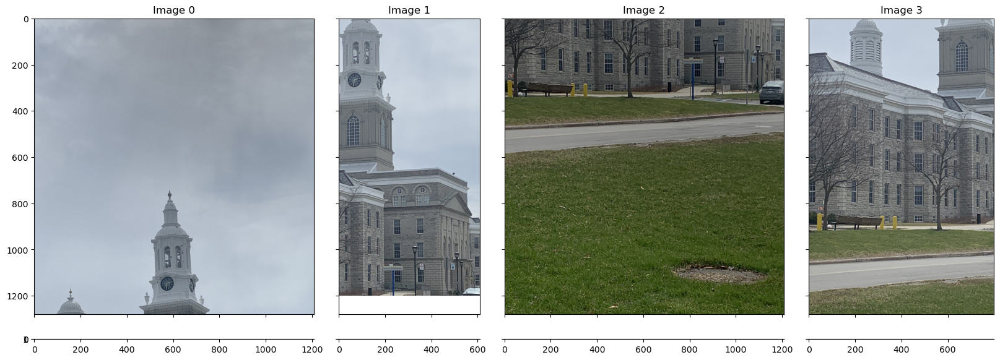

In [316]:
imgs11 = read_batch(BASE_PATH/'11', 0.4)
fd11 = extract_all_features(imgs11.values())
show_batch(imgs11.values())

In [318]:
x

array([[   0.,  392.,   38.,  323.],
       [ 392.,    0.,  445., 2695.],
       [  19.,  467.,    0.,  839.],
       [ 349., 2716.,  869.,    0.]])

In [315]:
x

array([[  0., 112.,   7.,  72.],
       [110.,   0., 101., 208.],
       [ 10., 122.,   0., 185.],
       [ 79., 215., 192.,   0.]])

In [330]:
x, overlap = get_overlap(imgs11, fd11, thresh=80, lowes_ratio=0.7)
x

array([[   0.,  392.,   38.,  323.],
       [ 392.,    0.,  445., 2695.],
       [  19.,  467.,    0.,  839.],
       [ 349., 2716.,  869.,    0.]])

In [329]:
overlap

array([[1., 1., 0., 1.],
       [1., 1., 1., 1.],
       [0., 1., 1., 1.],
       [1., 1., 1., 1.]])

------------------------------
iter: 0, imgs: 4

after h: inliers: 338
curr:0, nxt:1, n_matches_b:392, n_matches_a:338
after h: inliers: 5
curr:0, nxt:2, n_matches_b:19, n_matches_a:5
after h: inliers: 264
curr:0, nxt:3, n_matches_b:349, n_matches_a:264
curr:0, best_nxt:1, n_matches:338
after h: inliers: 317

Stitched 0, 1 | shape: (2156, 1209, 3)

after h: inliers: 616
curr:2, nxt:3, n_matches_b:869, n_matches_a:616
curr:2, best_nxt:3, n_matches:616
after h: inliers: 540

Stitched 2, 3 | shape: (2335, 1328, 3)

------------------------------
iter: 0, imgs: 2

after h: inliers: 1048
curr:0, nxt:1, n_matches_b:1276, n_matches_a:1048
curr:0, best_nxt:1, n_matches:1048
after h: inliers: 917

Stitched 0, 1 | shape: (4463, 1920, 3)

------------------------------
iter: 0, imgs: 1



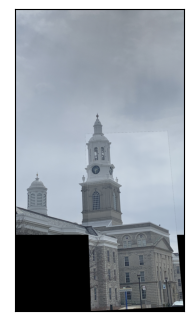

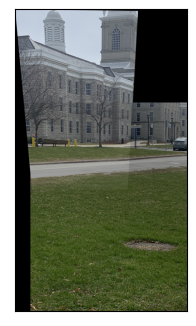

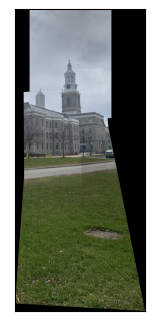

In [319]:
res = stitch_pano(
    list(imgs11.values()), ransac_thresh=10, match_thresh=50, lowes_ratio=0.7, show_inter=True, cv=True,
)

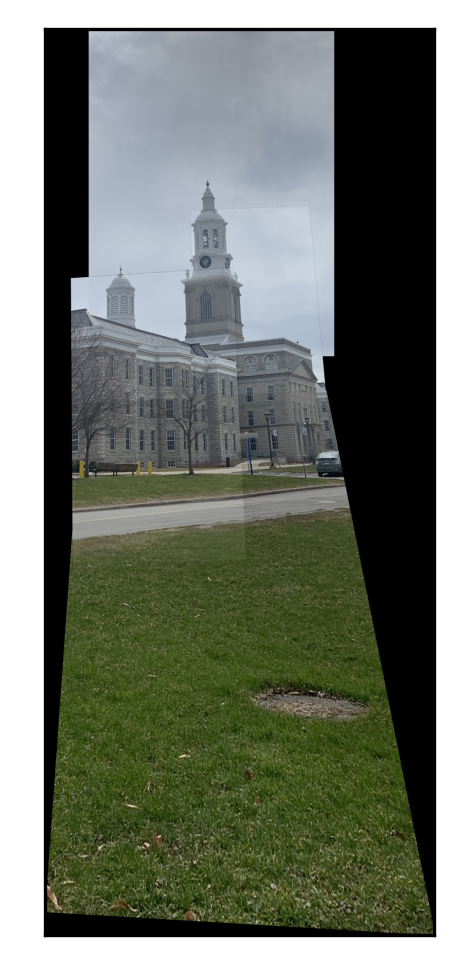

In [320]:
show(res, dpi=300)

In [321]:
for idx in imgs11:
    cv2.imwrite(f't3_{idx+1}.png', imgs11[idx])

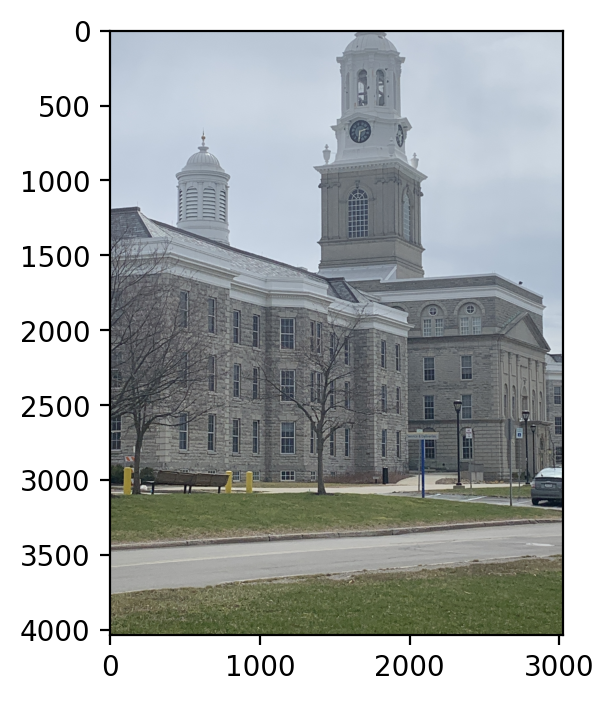

In [291]:
x = cv2.imread(str(BASE_PATH/'11/main.JPG'))
show(x, dpi=200, disable_axis=False)

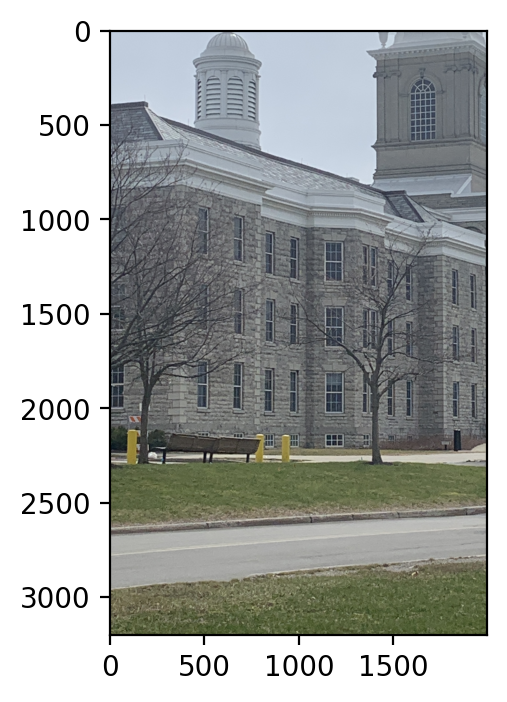

In [297]:
y = x[800:4000, 0:2000]
cv2.imwrite('main1.jpg', y)
show(x[800:4000, 0:2000], dpi=200, disable_axis=False)

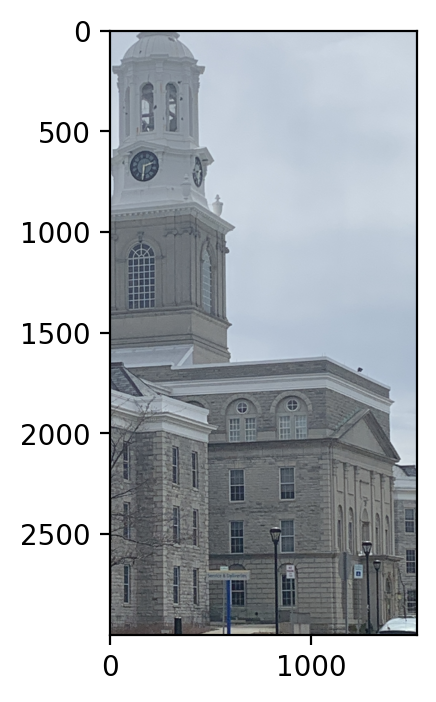

In [298]:
y = x[0:3000, 1500:3500]
cv2.imwrite('main2.jpg', y)
show(x[0:3000, 1500:3500], dpi=200, disable_axis=False)